In [1]:
import scvelo as scv
from IPython.display import clear_output
import matplotlib.backends.backend_pdf
from tqdm import tnrange, tqdm_notebook
import scanpy as sc
import matplotlib.pyplot as pl
import pandas as pd
import numpy as np
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline


scv.logging.print_version()
scv.settings.set_figure_params(
    'scvelo', dpi_save=100, dpi=80, transparent=True)
scv.settings.verbosity = 2

Running scvelo 0.1.16.dev32+c00a55e.dirty (python 3.6.6) on 2021-01-19 14:51.


In [2]:
# paths and names
data_path='G:/data/scSLAMseq/revision/'
signatures_path='G:/data/scrnaseq_signature_collection/'
figure_path='G:/data/figures/heatmaps/'
libraries = ['AB', 'CE', 'DF']
donors=['B2-040', 'C2-019', 'OT227', 'OT302', 'P009T', 'P013T']

# Stochastic model

In [3]:
donor=donors[-1]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed.h5')

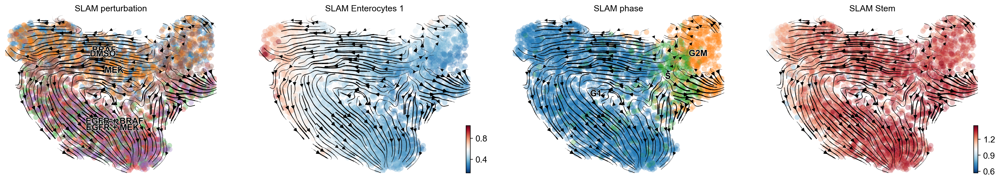

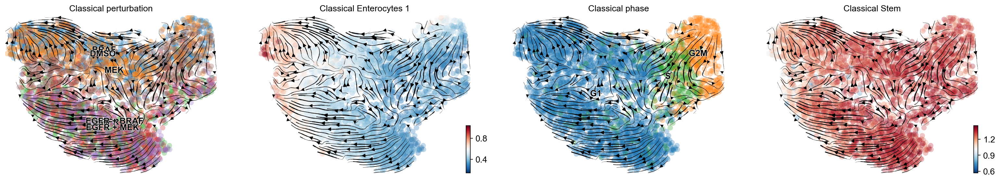

In [6]:
colors=['perturbation', 'Enterocytes 1', 'phase', 'Stem']
scv.pl.velocity_embedding_stream(adata, vkey='SLAM_velocity', color=colors, title=['SLAM ' + x for x in colors])
scv.pl.velocity_embedding_stream(adata, vkey='real_velocity', color=colors, title=['Classical ' + x for x in colors])

In [7]:
donor=donors[-2]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed.h5')

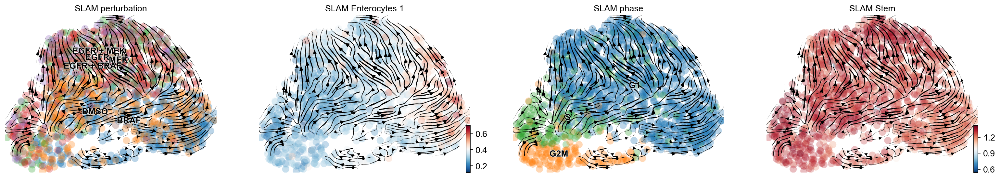

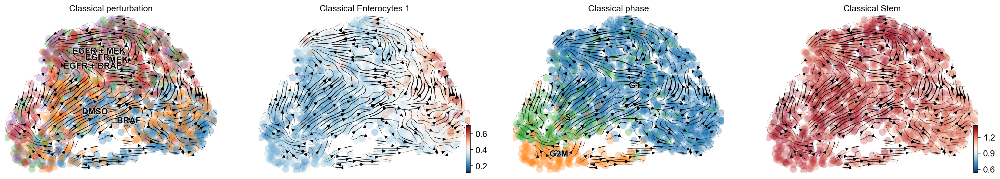

In [8]:
colors=['perturbation', 'Enterocytes 1', 'phase', 'Stem']
scv.pl.velocity_embedding_stream(adata, vkey='SLAM_velocity', color=colors, title=['SLAM ' + x for x in colors])
scv.pl.velocity_embedding_stream(adata, vkey='real_velocity', color=colors, title=['Classical ' + x for x in colors])

# Dyn Mod

In [162]:
def perturb_dynamics(subdata):
    scv.tl.recover_dynamics(subdata)

    topgenes=subdata[:, ~pd.isna(subdata.var['fit_likelihood'])].var['fit_likelihood'].sort_values()[-10:].index
    scv.pl.scatter(subdata, basis=list(topgenes), color=subdata.obsm['X_umap'][:,0])
    scv.pl.scatter(subdata, basis='umap', color=topgenes, layer='real_spliced')
    scv.pl.scatter(subdata, basis='umap', color=topgenes, layer='real_unspliced')

    if 'X_diffmap' in subdata.obsm.keys(): del subdata.obsm['X_diffmap']
    sc.pp.neighbors(subdata)
    scv.tl.velocity(subdata, mode='dynamical')
    scv.tl.velocity_graph(subdata)
    scv.tl.velocity_embedding(subdata, basis='umap')

    scv.pl.velocity_embedding_stream(subdata, color=['phase', subdata.obsm['X_umap'][:,0]], min_mass=2, density=0.5)
    return subdata

## Classical velocity

In [163]:
# load and filter data
donor=donors[-1]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed.h5')  # standard is classical/real u/s
scv.pp.filter_genes(adata, min_shared_counts=20)
print(adata.n_vars)

Filtered out 26996 genes that are detected 20 counts (shared).
4919


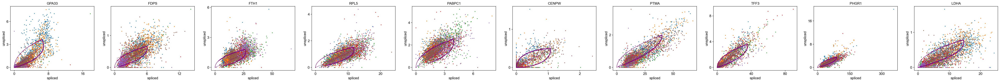

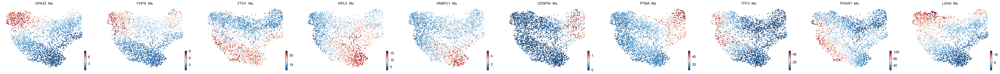

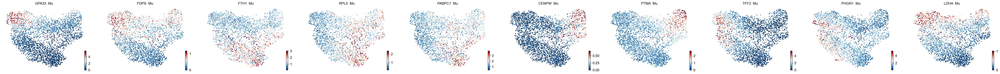

computing velocities
    finished (0:00:02)
computing velocity graph
    finished (0:00:06)
computing velocity embedding
    finished (0:00:00)


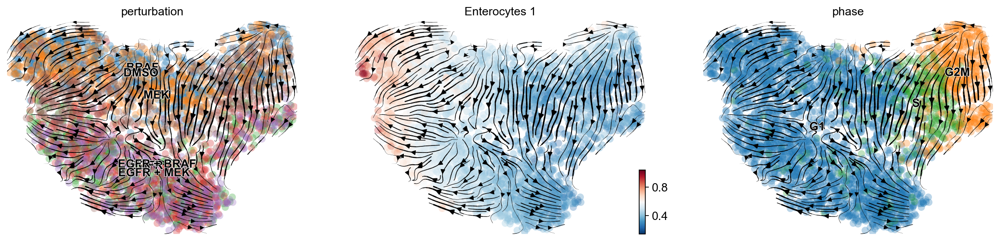

In [167]:
# learn dynamics on all perturbations
scv.tl.recover_dynamics(adata)

topgenes=adata[:, ~pd.isna(adata.var['fit_likelihood'])].var['fit_likelihood'].sort_values()[-10:].index
scv.pl.scatter(adata, basis=list(topgenes), color='perturbation')
scv.pl.scatter(adata, basis='umap', color=topgenes, layer='Ms')
scv.pl.scatter(adata, basis='umap', color=topgenes, layer='Mu')

scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)
scv.tl.velocity_embedding(adata, basis='umap')

scv.pl.velocity_embedding_stream(adata, color=['perturbation', 'Enterocytes 1', 'phase'])

Filtered out 2824 genes that are detected 20 counts (shared).
2095
recovering dynamics
    finished (0:00:57)


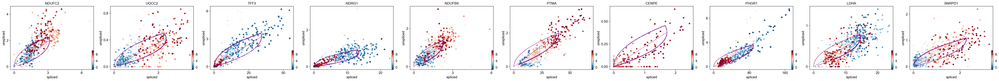

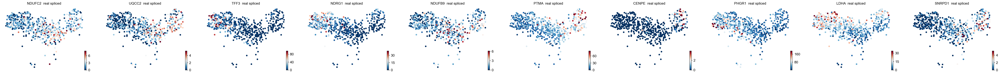

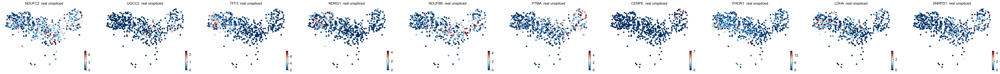

computing velocities
    finished (0:00:00)
computing velocity graph
    finished (0:00:00)
computing velocity embedding
    finished (0:00:00)


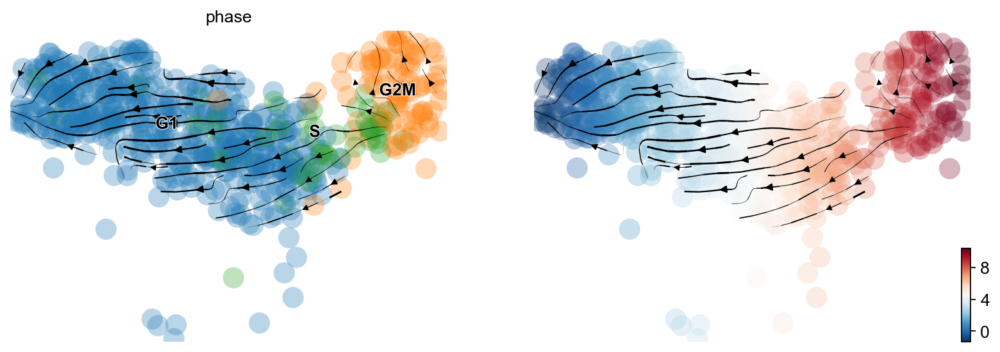

In [165]:
# learn dynamics on single perturbation
subdata=adata[adata.obs.perturbation=='DMSO'].copy()
scv.pp.filter_genes(subdata, min_shared_counts=20)
print(subdata.n_vars)

subdata = perturb_dynamics(subdata)

Filtered out 2745 genes that are detected 20 counts (shared).
2174
recovering dynamics
    finished (0:00:51)


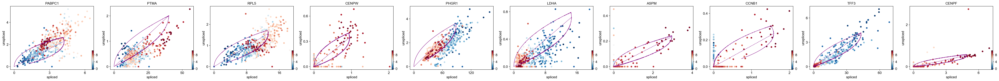

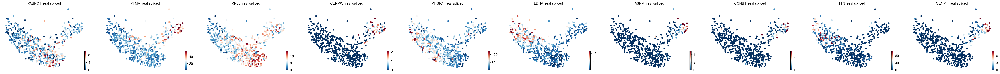

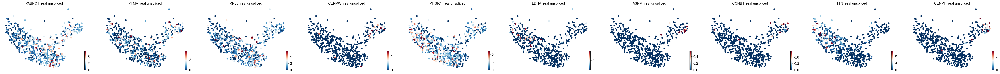

computing velocities
    finished (0:00:00)
computing velocity graph
    finished (0:00:00)
computing velocity embedding
    finished (0:00:00)


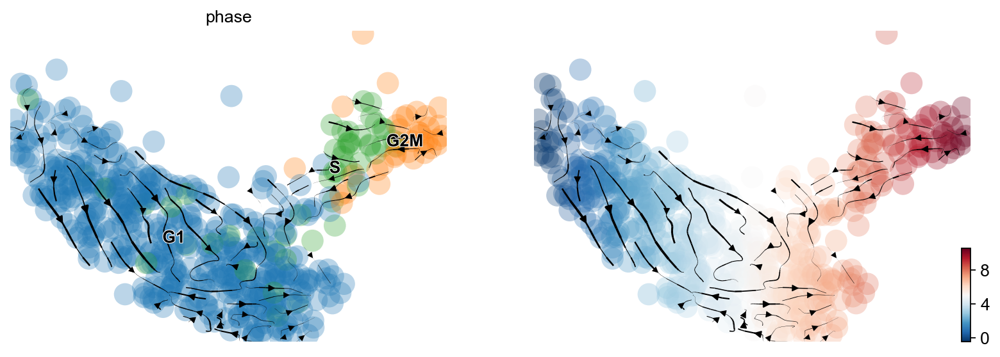

In [166]:
# learn dynamics on single perturbation
subdata=adata[adata.obs.perturbation=='EGFR'].copy()
scv.pp.filter_genes(subdata, min_shared_counts=20)
print(subdata.n_vars)

subdata = perturb_dynamics(subdata)

## SLAM velocity

In [47]:
donor=donors[-1]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed.h5')  # standard is classical/real u/s
adata.layers['unspliced']=adata.layers['new']
adata.layers['spliced']=adata.layers['old']
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
scv.pp.filter_genes(adata, min_shared_counts=20)
print(adata.n_vars)

computing moments based on connectivities
    finished (0:00:01)
Filtered out 25643 genes that are detected 20 counts (shared).
6272


recovering dynamics
    finished (0:13:38)


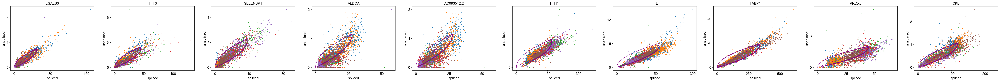

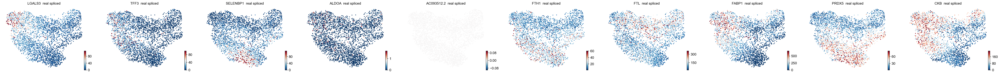

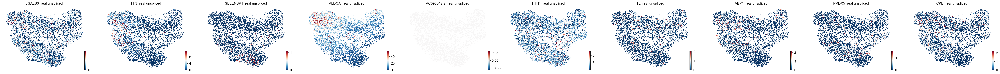

computing velocities
    finished (0:00:05)
computing velocity graph
    finished (0:00:13)
computing velocity embedding
    finished (0:00:00)


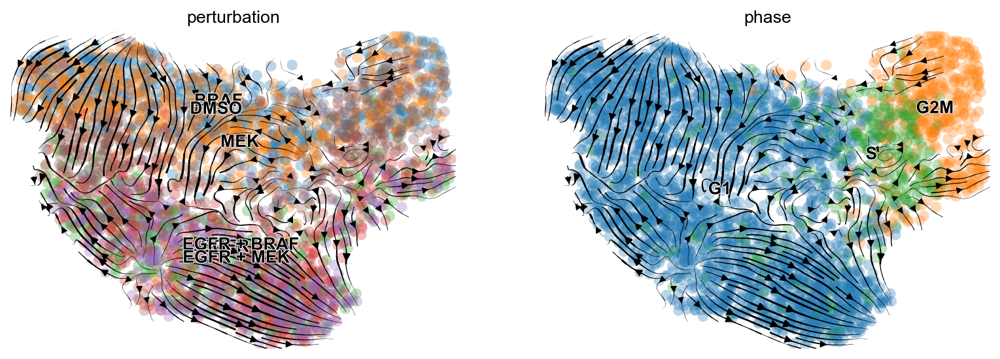

In [48]:
scv.tl.recover_dynamics(adata)

topgenes=adata[:, ~pd.isna(adata.var['fit_likelihood'])].var['fit_likelihood'].sort_values()[-10:].index
scv.pl.scatter(adata, basis=list(topgenes), color='perturbation')
scv.pl.scatter(adata, basis='umap', color=topgenes, layer='real_spliced')
scv.pl.scatter(adata, basis='umap', color=topgenes, layer='real_unspliced')

scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)
scv.tl.velocity_embedding(adata, basis='umap')

scv.pl.velocity_embedding_stream(adata, color=['perturbation', 'phase'])

Filtered out 3477 genes that are detected 20 counts (shared).
2795
recovering dynamics
    finished (0:02:19)


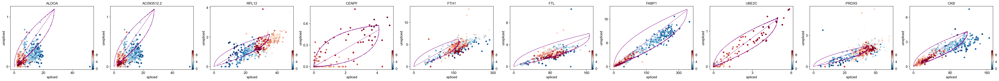

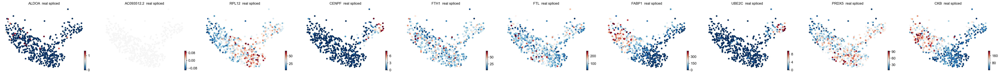

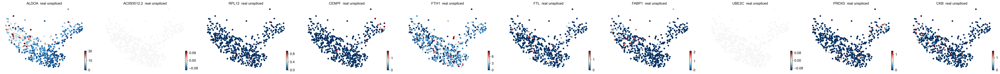

computing velocities
    finished (0:00:00)
computing velocity graph
    finished (0:00:00)
computing velocity embedding
    finished (0:00:00)


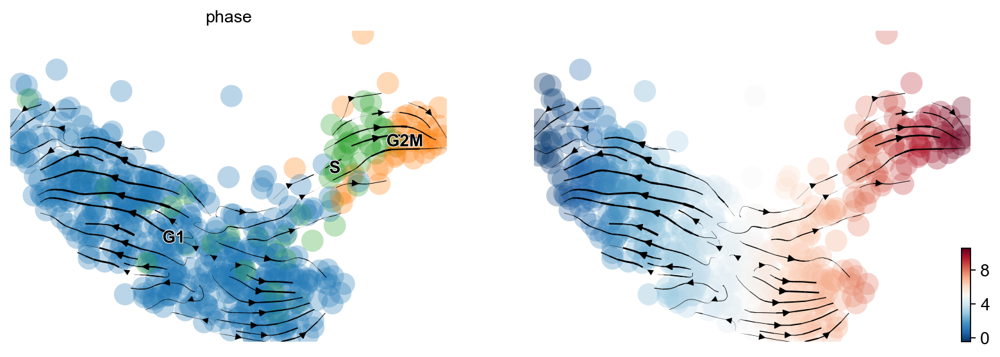

In [49]:
# learn dynamics on single perturbation
subdata=adata[adata.obs.perturbation=='EGFR'].copy()
scv.pp.filter_genes(subdata, min_shared_counts=20)
print(subdata.n_vars)

subdata = perturb_dynamics(subdata)

Filtered out 3687 genes that are detected 20 counts (shared).
2585
recovering dynamics
    finished (0:02:26)


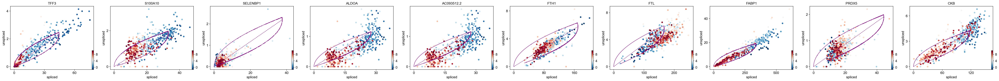

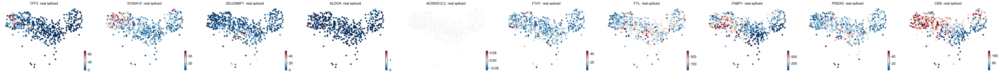

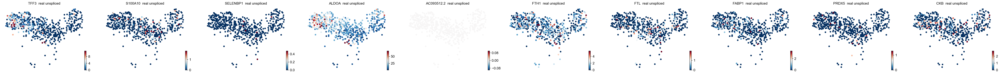

computing velocities
    finished (0:00:00)
computing velocity graph
    finished (0:00:00)
computing velocity embedding
    finished (0:00:00)


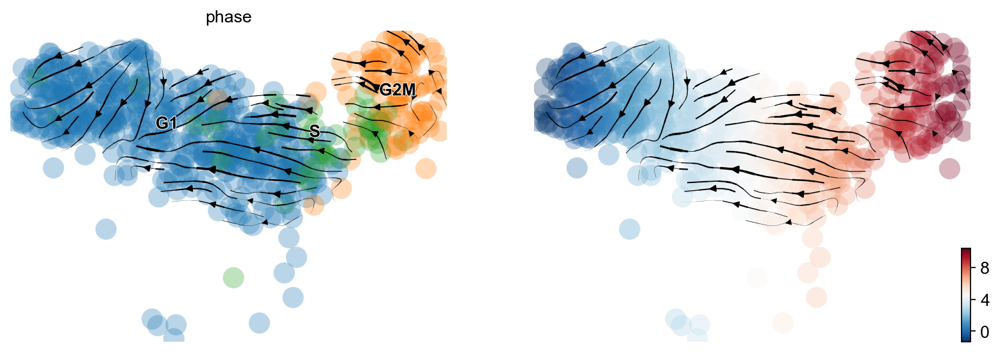

In [51]:
# learn dynamics on single perturbation
subdata=adata[adata.obs.perturbation=='DMSO'].copy()
scv.pp.filter_genes(subdata, min_shared_counts=20)
print(subdata.n_vars)

subdata = perturb_dynamics(subdata)

# Compare modalities per gene

In [ ]:
donor=donors[-1]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed.h5')  # standard is classical/real u/s

In [122]:
bdata=adata.copy()
bdata.layers['unspliced']=adata.layers['new'].copy()
bdata.layers['spliced']=adata.layers['old'].copy()
scv.pp.moments(bdata, n_pcs=30, n_neighbors=30)
adata.layers['SLAM_Ms'] = bdata.layers['Ms'].copy()
adata.layers['SLAM_Mu'] = bdata.layers['Mu'].copy()
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
adata.layers['Classical_Ms'] = adata.layers['Ms'].copy()
adata.layers['Classical_Mu'] = adata.layers['Mu'].copy()
del bdata

computing moments based on connectivities
    finished (0:00:02)
computing moments based on connectivities
    finished (0:00:05)


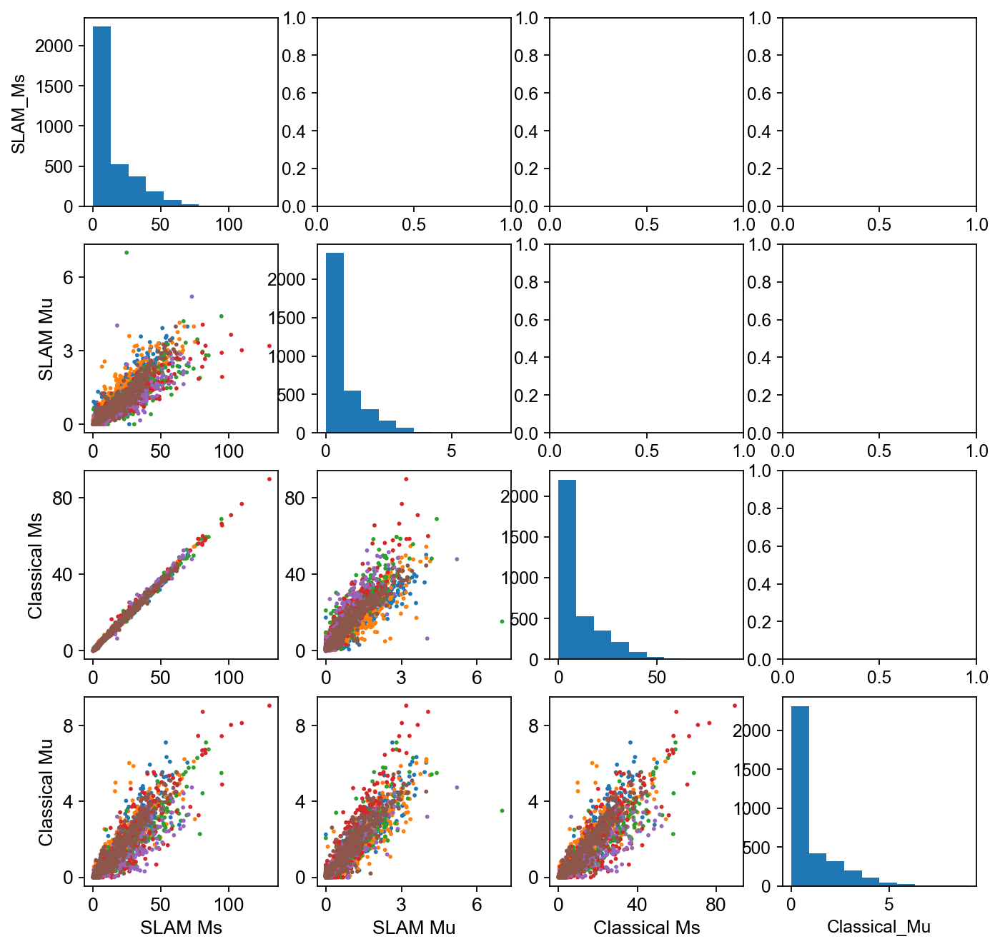

In [129]:
# correlation plots
gene = 'TFF3'
# reminder: spliced = old, because it was around for longer time.

layers=['SLAM_Ms', 'SLAM_Mu', 'Classical_Ms', 'Classical_Mu']
for i, L1 in enumerate(layers):
    for j, L2 in enumerate(layers):
        if j>i:
            xlabel= '' if j!=3 else L1
            ylabel= '' if i!=0 else L2
            scv.pl.scatter(adata, basis=gene, x=L1, y=L2,ax=axs[j,i], show=False, title='', xlabel=xlabel, ylabel=ylabel, color='perturbation');
        if j==i:
            axs[i,j].hist(adata[:,gene].layers[L1].copy())
            if j==3: axs[i,j].set_xlabel(L1)
            if i==0: axs[i,j].set_ylabel(L2)
pl.show()

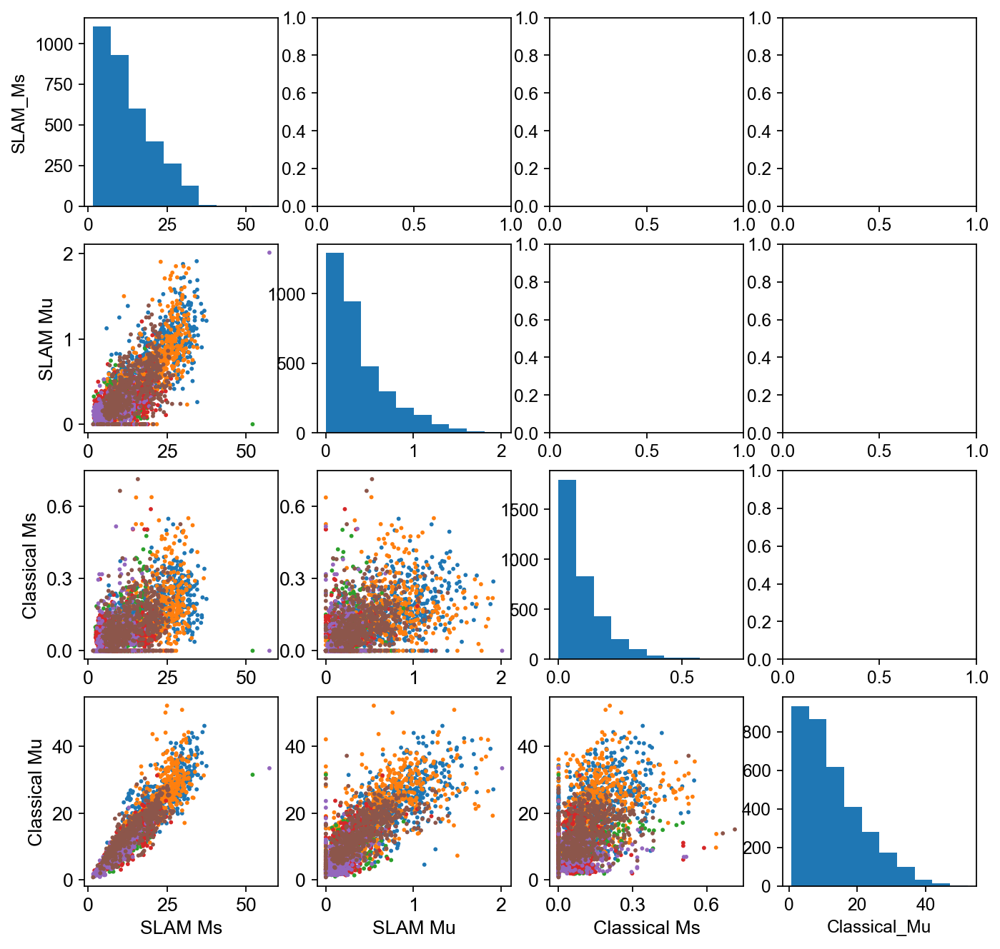

In [128]:
# correlation plots
gene = 'ALDOA'
# reminder: spliced = old, because it was around for longer time.

fig, axs = pl.subplots(4,4, figsize=[10,10])
layers=['SLAM_Ms', 'SLAM_Mu', 'Classical_Ms', 'Classical_Mu']
for i, L1 in enumerate(layers):
    for j, L2 in enumerate(layers):
        if j>i:
            xlabel= '' if j!=3 else L1
            ylabel= '' if i!=0 else L2
            scv.pl.scatter(adata, basis=gene, x=L1, y=L2, ax=axs[j,i], show=False, title='', xlabel=xlabel, ylabel=ylabel, color='perturbation');
        if j==i:
            axs[i,j].hist(adata[:,gene].layers[L1].copy())
            if j==3: axs[i,j].set_xlabel(L1)
            if i==0: axs[i,j].set_ylabel(L2)
pl.show()

In [131]:
slayers=['SLAM_Ms', 'Classical_Ms']
ulayers=['SLAM_Mu', 'Classical_Mu']

In [150]:
U=np.array([np.mean(adata[:, topgenes].layers[ulayers[0]], axis=0), np.mean(adata[:, topgenes].layers[ulayers[1]], axis=0)])
S=np.array([np.mean(adata[:, topgenes].layers[slayers[0]], axis=0), np.mean(adata[:, topgenes].layers[slayers[1]], axis=0)])

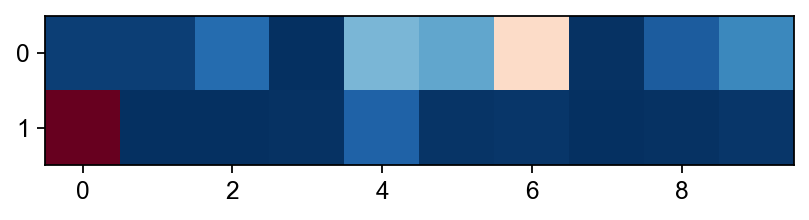

In [153]:
pl.imshow(U);

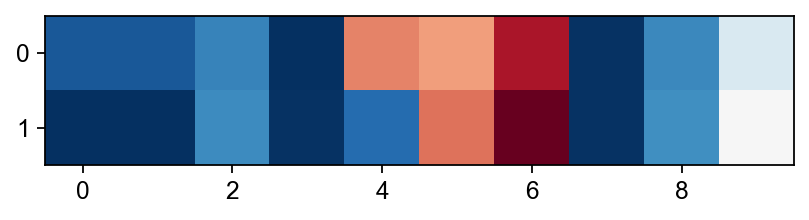

In [154]:
pl.imshow(S);

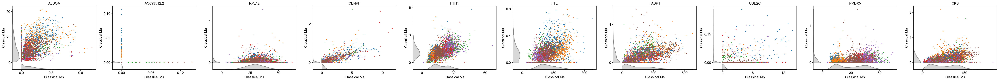

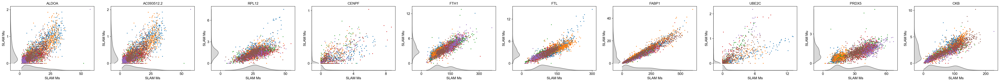

In [160]:
scv.pl.scatter(adata, basis=topgenes, x='Classical_Ms', y='Classical_Mu', color='perturbation', add_density=True);
scv.pl.scatter(adata, basis=topgenes, x='SLAM_Ms', y='SLAM_Mu', color='perturbation', add_density=True);

# new

In [ ]:
donor=donors[-1]
adata = scv.read(data_path+'by_donors/processed/SLAMv2_'+donor+'_processed_ccreg.h5')

In [ ]:
scv.pl.scatter(adata, color='perturbation')

In [ ]:
scv.pl.scatter(adata, basis='TFF3')

In [ ]:
scv.pl.scatter(adata, x=adata.obsm['X_umap'][:,0], y=[adata[:, 'TFF3'].X], n_convolve=20)
scv.pl.scatter(adata, x=adata.obsm['X_umap'][:,0], y=adata[:, 'KRT19'].X, n_convolve=20)

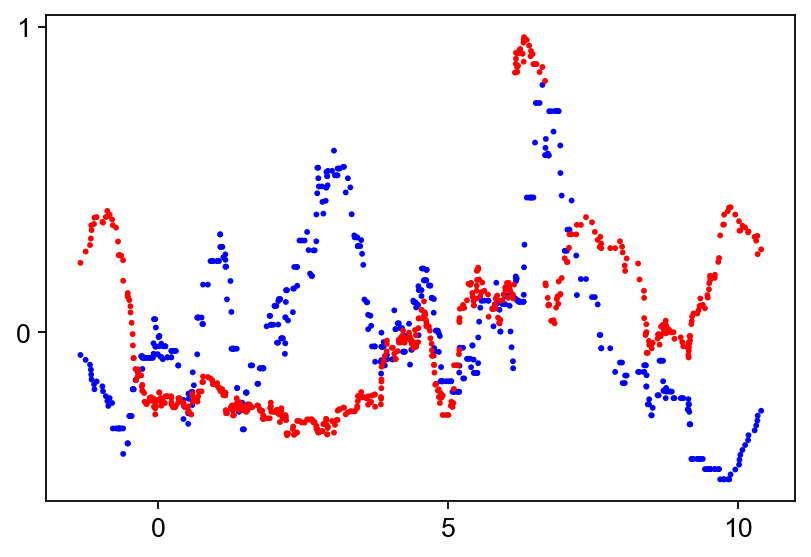

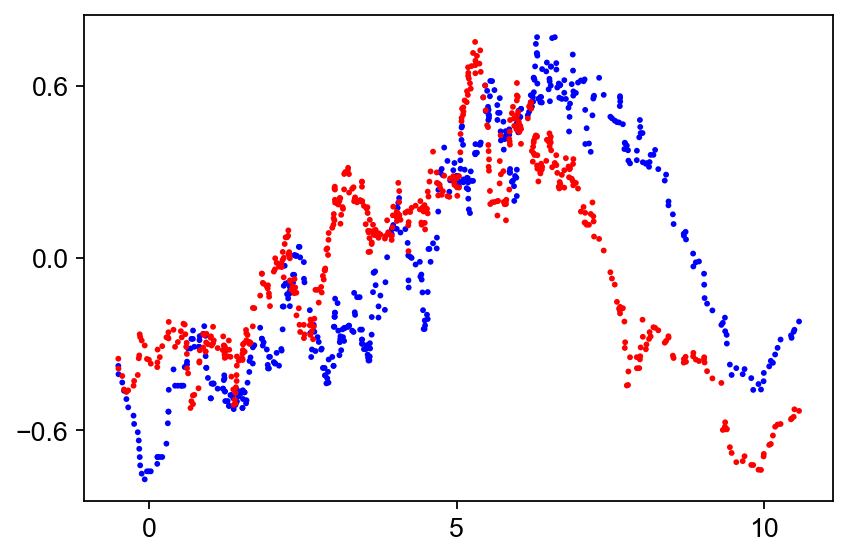

In [50]:
from scipy.stats import zscore

kwargs = {'n_convolve': 30, 'show': False}
gene = 'AXIN2'
dim=0

ix = adata.obs.perturbation=='DMSO'
ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Ms']), color='blue', **kwargs)
ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Mu']), ax=ax, color='red', **kwargs)

ix = adata.obs.perturbation=='EGFR'
ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Ms']), color='blue', **kwargs)
ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Mu']), ax=ax, color='red', **kwargs)

In [52]:
bdata=adata.copy()
bdata.layers['unspliced']=adata.layers['new'].copy()
bdata.layers['spliced']=adata.layers['old'].copy()
scv.pp.moments(bdata, n_pcs=30, n_neighbors=30)
adata.layers['SLAM_Ms'] = bdata.layers['Ms'].copy()
adata.layers['SLAM_Mu'] = bdata.layers['Mu'].copy()
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
adata.layers['Classical_Ms'] = adata.layers['Ms'].copy()
adata.layers['Classical_Mu'] = adata.layers['Mu'].copy()
del bdata

computing moments based on connectivities
    finished (0:00:02)
computing moments based on connectivities
    finished (0:00:26)


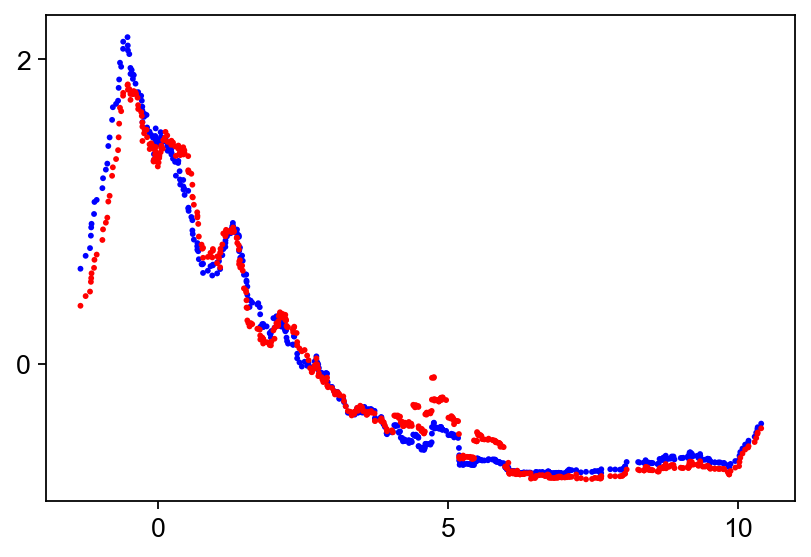

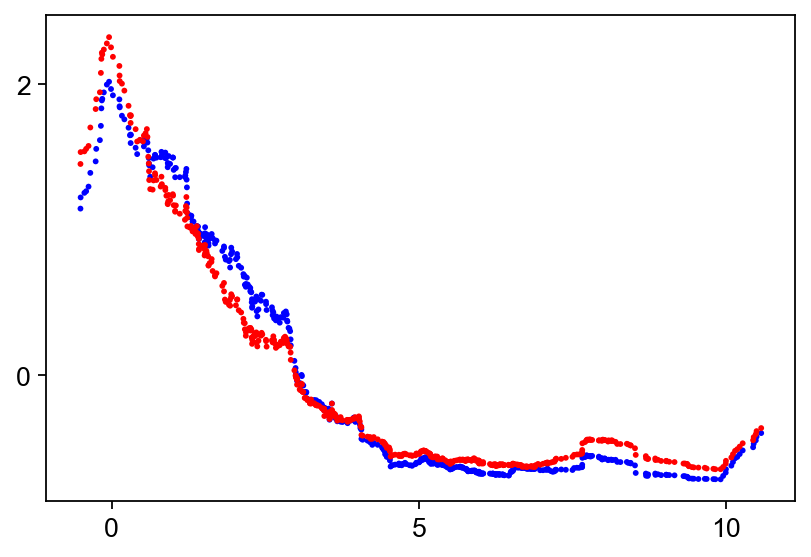

In [62]:
from scipy.stats import zscore

kwargs = {'n_convolve': 30, 'show': False}
gene = 'TFF3'
dim=0
layer0='Classical_Ms'
layer1='Classical_Mu'

for pert in ['DMSO', 'EGFR']:
    ix = adata.obs.perturbation==pert
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers[layer0]), color='blue', **kwargs)
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers[layer1]), ax=ax, color='red', **kwargs)


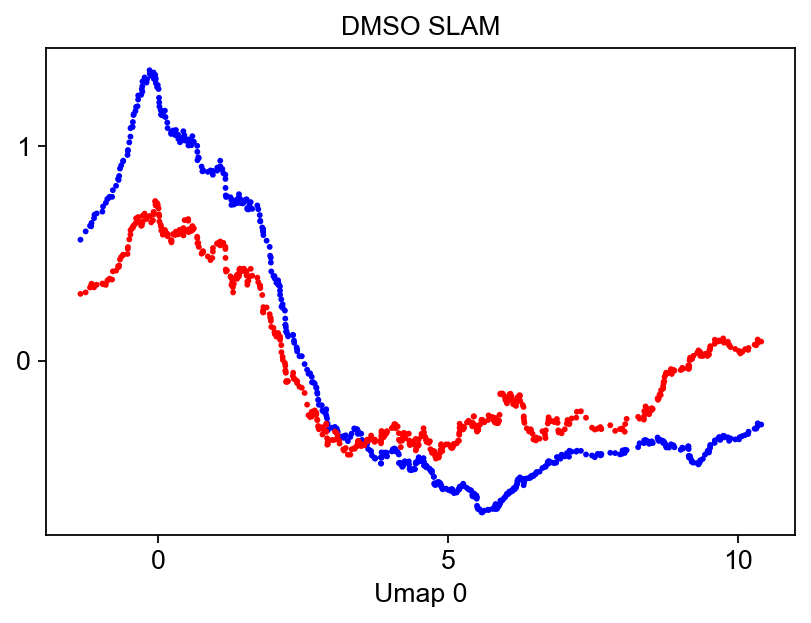

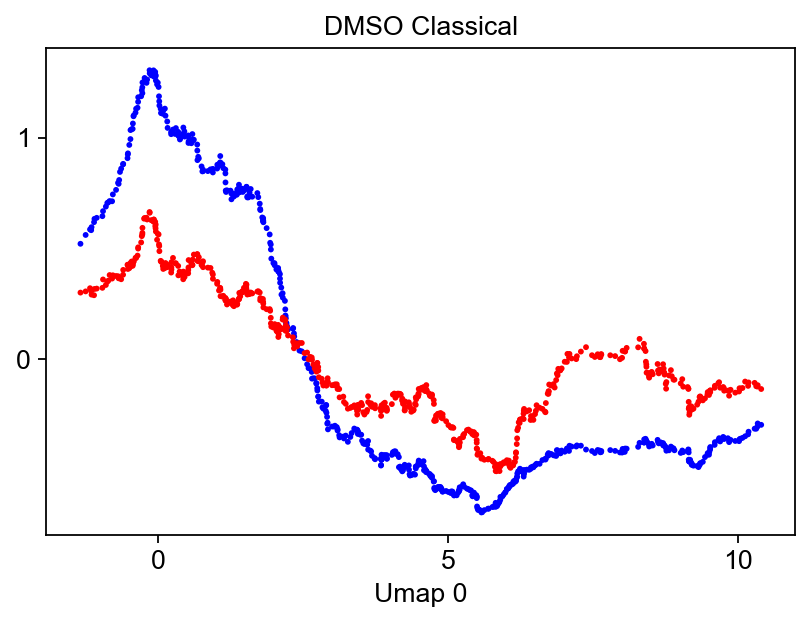

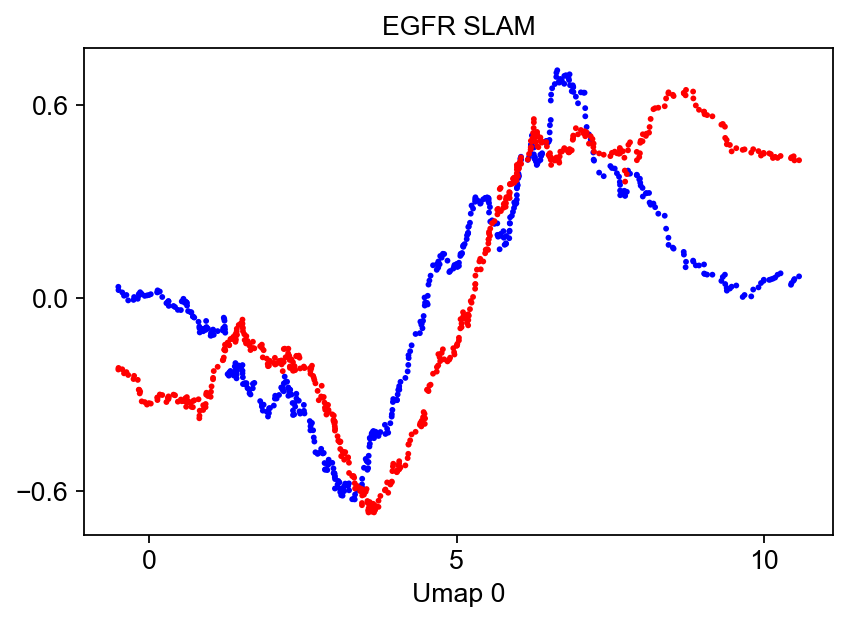

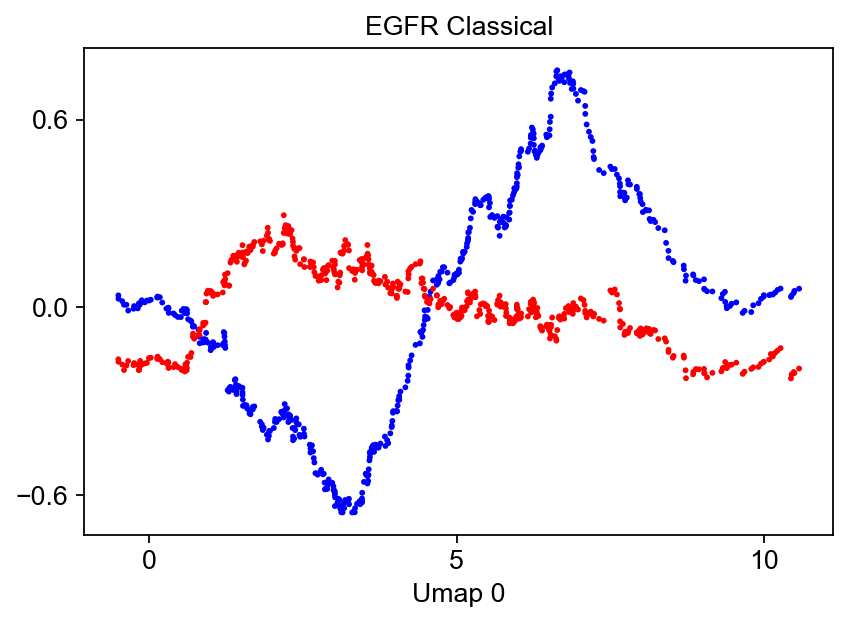

In [79]:
from scipy.stats import zscore


gene = 'TMSB10'
dim=0
kwargs = {'n_convolve': 75, 'show': False, 'xlabel': 'Umap '+str(dim)}
layer0='Ms'
layer1='Mu'

for pert in ['DMSO', 'EGFR']:
    ix = adata.obs.perturbation==pert
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['SLAM_'+layer0]), color='blue', **kwargs)
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['SLAM_'+layer1]), ax=ax, color='red', title=pert+' SLAM', **kwargs)
    
    ix = adata.obs.perturbation==pert
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Classical_'+layer0]), color='blue', **kwargs)
    ax = scv.pl.scatter(adata, x=adata.obsm['X_umap'][ix,dim], y=zscore(adata[ix, gene].layers['Classical_'+layer1]), ax=ax, color='red', title=pert+' Classical', **kwargs)


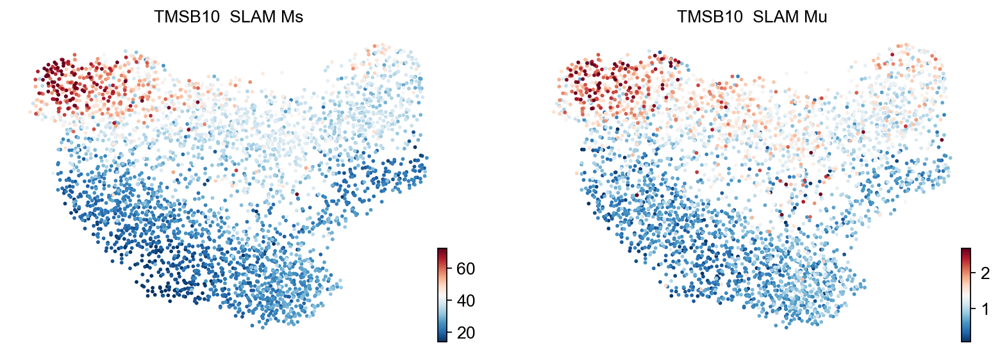

In [81]:
scv.pl.scatter(adata, color='TMSB10', layer=['SLAM_Ms', 'SLAM_Mu'])